In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import sklearn
%matplotlib inline

In [2]:
dataset=pd.read_csv("transactions_n100000.csv")

In [3]:
dataset.head()

,ticket_id,order_timestamp,location,item_name,item_count,lat,long
0,0x7901ee,2019-01-16 18:33:00,7,shake,2,41.794132,-88.010140
1,0x7901ee,2019-01-16 18:33:00,7,burger,2,41.794132,-88.010140
2,0x7901ee,2019-01-16 18:33:00,7,fries,2,41.794132,-88.010140
3,0x12b47f,2019-09-04 12:36:00,3,salad,1,41.884490,-87.627059
4,0x12b47f,2019-09-04 12:36:00,3,fries,1,41.884490,-87.627059


Selecting features columns

In [4]:
# create a "pivot table" which will give us the number of times each order responded to a given item_name
matrix = dataset.pivot_table(index=['ticket_id'], columns=['item_name'], values='item_count')
# a little tidying up. fill NA values with 0 and make the index into a column
matrix = matrix.fillna(0).reset_index()
# save a list of the 0/1 columns. we'll use these a bit later
x_cols = matrix.columns[1:]

In [5]:
# new_matrix = matrix.merge(dataset[['ticket_id','location']])

In [6]:
matrix.head()
# new_matrix.head()

item_name,ticket_id,burger,fries,salad,shake
0,0x10000a,1.0,1.0,0.0,0.0
1,0x100058,2.0,2.0,0.0,0.0
2,0x1000c8,4.0,5.0,1.0,4.0
3,0x10014c,1.0,1.0,0.0,0.0
4,0x1001d8,3.0,3.0,0.0,3.0


In [7]:
# df=new_matrix.iloc[:,1:]
df=matrix.iloc[:,1:]

In [8]:
df.head()

item_name,burger,fries,salad,shake
0,1.0,1.0,0.0,0.0
1,2.0,2.0,0.0,0.0
2,4.0,5.0,1.0,4.0
3,1.0,1.0,0.0,0.0
4,3.0,3.0,0.0,3.0


In [9]:
#Features Matrix
X=df.values

Cluster Analysis
First Step is to find the Number of Cluster

Finding optimal number of cluster using dendrogram

In [10]:
# Memory issue
# import scipy
# from scipy.cluster import hierarchy
# dendro=hierarchy.dendrogram(hierarchy.linkage(X,method='ward'))

Text(0, 0.5, 'wcss: sum of dist. of sample to their closest cluster center')

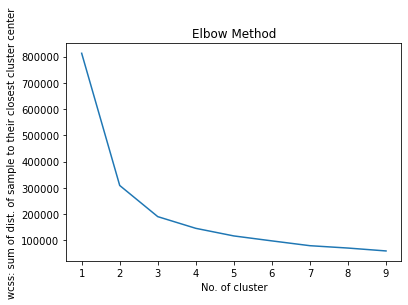

In [11]:
from sklearn.cluster import KMeans
wcss=[]
for i in range(1,10):
    kmeans=KMeans(n_clusters=i,init='k-means++',)
    kmeans.fit(X)
    wcss.append(kmeans.inertia_)
    
plt.plot(range(1,10),wcss)
plt.title('Elbow Method')
plt.xlabel('No. of cluster')
plt.ylabel('wcss: sum of dist. of sample to their closest cluster center' )

In [12]:
# KMeans Clustering Model with 3 cluster

kmeans_1=KMeans(n_clusters=3)
kmeans_1.fit(X)
cluster_pred=kmeans_1.predict(X)
cluster_pred_2=kmeans_1.labels_
cluster_center=kmeans_1.cluster_centers_

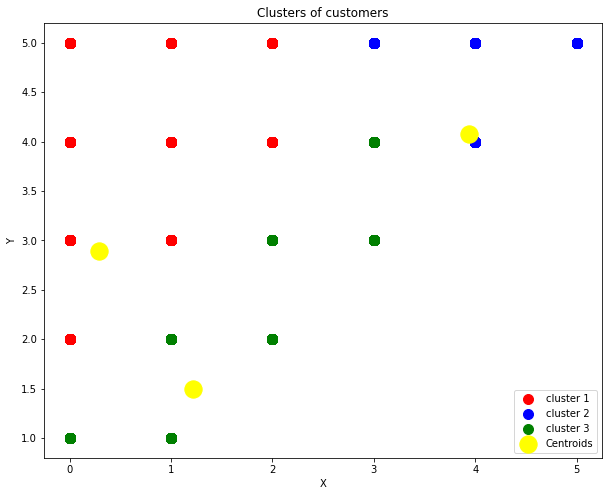

In [13]:
# Visualising the clusters
plt.figure(figsize=(10,8))
plt.scatter(X[cluster_pred==0,0],X[cluster_pred==0,1], s = 100, c = 'red', label ='cluster 1' )
plt.scatter(X[cluster_pred==1,0],X[cluster_pred==1,1], s = 100, c = 'blue', label ='cluster 2' )
plt.scatter(X[cluster_pred==2,0],X[cluster_pred==2,1], s = 100, c = 'green', label ='cluster 3' )
# plt.scatter(X[cluster_pred==3,0],X[cluster_pred==3,1], s = 100, c = 'cyan', label = 'cluster 4')
# plt.scatter(X[cluster_pred==4,0],X[cluster_pred==4,1], s = 100, c = 'magenta', label = 'cluster 5')
plt.scatter(cluster_center[:,0],cluster_center[:,1], s = 300, c = 'yellow', label = 'Centroids')
plt.title('Clusters of customers')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()

### 1.Descriptive analysis

In [14]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import matplotlib.pyplot as plt 
import seaborn as sns 
import plotly as py
import plotly.graph_objs as go
from sklearn.cluster import KMeans
import warnings
import os
warnings.filterwarnings("ignore")
py.offline.init_notebook_mode(connected = True)
#print(os.listdir("../input"))

月份-食物

In [15]:
df = pd.read_csv("transactions_n100000.csv")
df.head()

,ticket_id,order_timestamp,location,item_name,item_count,lat,long
0,0x7901ee,2019-01-16 18:33:00,7,shake,2,41.794132,-88.010140
1,0x7901ee,2019-01-16 18:33:00,7,burger,2,41.794132,-88.010140
2,0x7901ee,2019-01-16 18:33:00,7,fries,2,41.794132,-88.010140
3,0x12b47f,2019-09-04 12:36:00,3,salad,1,41.884490,-87.627059
4,0x12b47f,2019-09-04 12:36:00,3,fries,1,41.884490,-87.627059


In [16]:
# create a "pivot table" which will give us the number of times each order responded to a given item_name
matrix = df.pivot_table(index=['ticket_id'], columns=['item_name'], values='item_count')
# a little tidying up. fill NA values with 0 and make the index into a column
matrix = matrix.fillna(0).reset_index()
# save a list of the 0/1 columns. we'll use these a bit later
x_cols = matrix.columns[1:]

In [17]:
matrix.shape

(100000, 5)

In [18]:
matrix.describe()

item_name,burger,fries,salad,shake
count,100000.000000,100000.000000,100000.000000,100000.000000
mean,1.857840,2.569210,0.711370,1.239590
std,1.588589,1.332084,1.086524,1.627886
min,0.000000,1.000000,0.000000,0.000000
25%,1.000000,1.000000,0.000000,0.000000
50%,1.000000,2.000000,0.000000,0.000000
75%,3.000000,4.000000,1.000000,3.000000
max,5.000000,5.000000,5.000000,5.000000


In [19]:
new_matrix = matrix.merge(df[['ticket_id','location']])

In [20]:
new_matrix.dtypes

ticket_id     object
burger       float64
fries        float64
salad        float64
shake        float64
location       int64
dtype: object

In [21]:
new_matrix.isnull().sum()

ticket_id    0
burger       0
fries        0
salad        0
shake        0
location     0
dtype: int64

In [22]:
plt.style.use('fivethirtyeight')

In [23]:
df = new_matrix

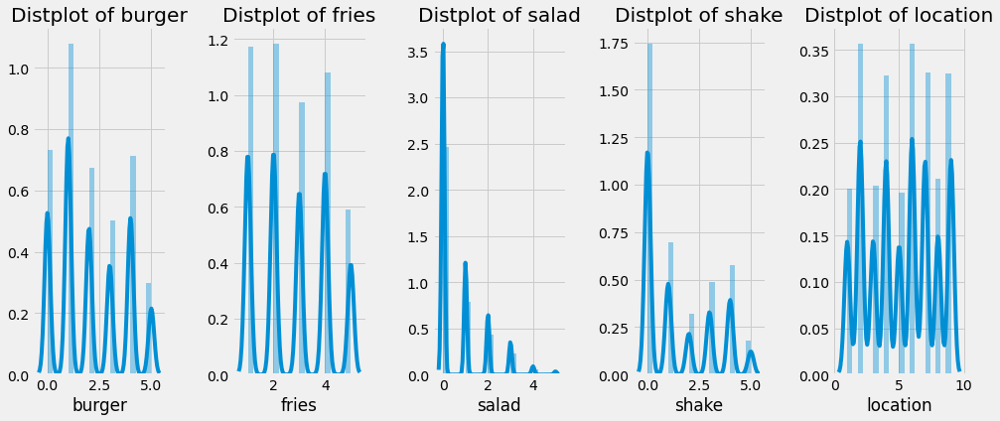

In [24]:
plt.figure(1 , figsize = (15 , 6))
n = 0 
for x in ['burger' , 'fries' , 'salad', 'shake', 'location']:
    n += 1
    plt.subplot(1 , 5 , n)
    plt.subplots_adjust(hspace =0.5 , wspace = 0.5)
    sns.distplot(df[x] , bins = 20)
    plt.title('Distplot of {}'.format(x))
plt.show()

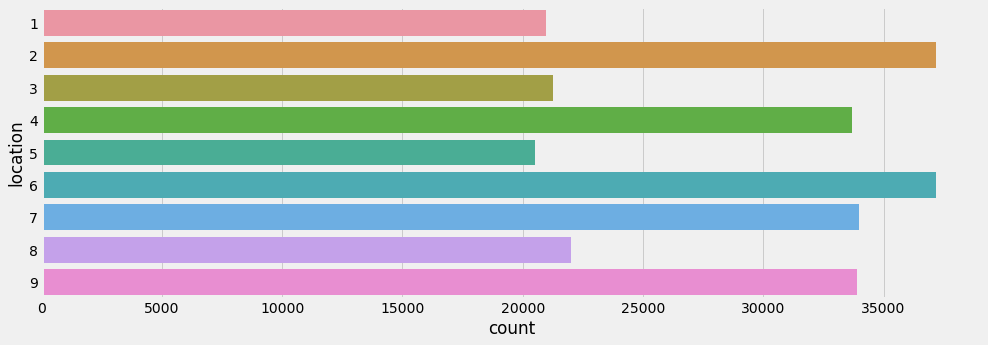

In [25]:
plt.figure(1 , figsize = (15 , 5))
sns.countplot(y = 'location' , data = df)
plt.show()

In [26]:
# # time consumming
# plt.figure(1 , figsize = (15 , 7))
# n = 0 
# for x in ['burger' , 'fries' , 'salad', 'shake']:
#     for y in ['burger' , 'fries' , 'salad', 'shake']:
#         n += 1
#         plt.subplot(4 , 4 , n)
#         plt.subplots_adjust(hspace = 0.5 , wspace = 0.5)
#         sns.regplot(x = x , y = y , data = df)
#         plt.ylabel(y.split()[0]+' '+y.split()[1] if len(y.split()) > 1 else y )
# plt.show()

In [27]:
# plt.figure(1 , figsize = (15 , 6))
# for gender in ['Male' , 'Female']:
#     plt.scatter(x = 'Age' , y = 'Annual Income (k$)' , data = df[df['Gender'] == gender] ,
#                 s = 200 , alpha = 0.5 , label = gender)
# plt.xlabel('Age'), plt.ylabel('Annual Income (k$)') 
# plt.title('Age vs Annual Income w.r.t Gender')
# plt.legend()
# plt.show()

### burger fries

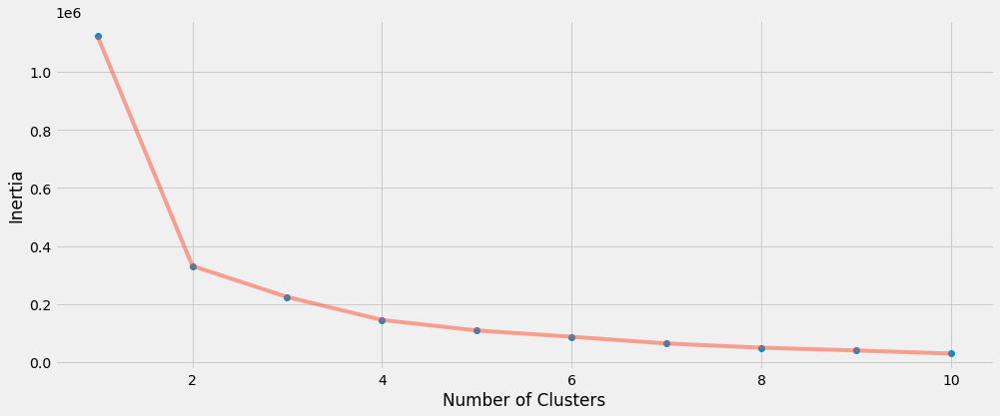

In [50]:
'''burger and fries'''
X1 = df[['burger' , 'fries']].iloc[: , :].values
inertia = []
for n in range(1 , 11):
    algorithm = (KMeans(n_clusters = n ,init='k-means++', n_init = 10 ,max_iter=300, 
                        tol=0.0001,  random_state= 111  , algorithm='elkan') )
    algorithm.fit(X1)
    inertia.append(algorithm.inertia_)
plt.figure(1 , figsize = (15 ,6))
plt.plot(np.arange(1 , 11) , inertia , 'o')
plt.plot(np.arange(1 , 11) , inertia , '-' , alpha = 0.5)
plt.xlabel('Number of Clusters') , plt.ylabel('Inertia')
plt.show()

In [51]:
algorithm = (KMeans(n_clusters = 2 ,init='k-means++', n_init = 10 ,max_iter=300, 
                        tol=0.0001,  random_state= 111  , algorithm='elkan') )
algorithm.fit(X1)
labels1 = algorithm.labels_
centroids1 = algorithm.cluster_centers_
h = 0.02
x_min, x_max = X1[:, 0].min() - 1, X1[:, 0].max() + 1
y_min, y_max = X1[:, 1].min() - 1, X1[:, 1].max() + 1
xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))
Z = algorithm.predict(np.c_[xx.ravel(), yy.ravel()]) 
plt.figure(1 , figsize = (15 , 7) )
plt.clf()
Z = Z.reshape(xx.shape)

<Figure size 1080x504 with 0 Axes>

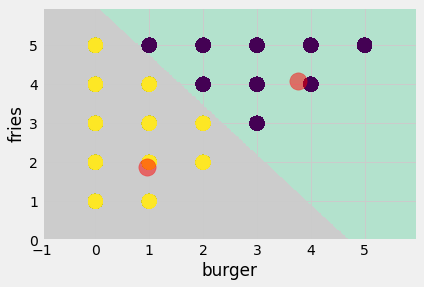

In [52]:

plt.imshow(Z , interpolation='nearest', 
           extent=(xx.min(), xx.max(), yy.min(), yy.max()),
           cmap = plt.cm.Pastel2, aspect = 'auto', origin='lower')

plt.scatter( x = 'burger' ,y = 'fries' , data = df , c = labels1 , 
            s = 200 )
plt.scatter(x = centroids1[: , 0] , y =  centroids1[: , 1] , s = 300 , c = 'red' , alpha = 0.5)
plt.ylabel('fries') , plt.xlabel('burger')
plt.show()

### 2.1 Segmentation using burger and salad

In [53]:
'''burger and salad'''
X1 = df[['burger' , 'salad']].iloc[: , :].values
inertia = []
for n in range(1 , 11):
    algorithm = (KMeans(n_clusters = n ,init='k-means++', n_init = 10 ,max_iter=300, 
                        tol=0.0001,  random_state= 111  , algorithm='elkan') )
    algorithm.fit(X1)
    inertia.append(algorithm.inertia_)


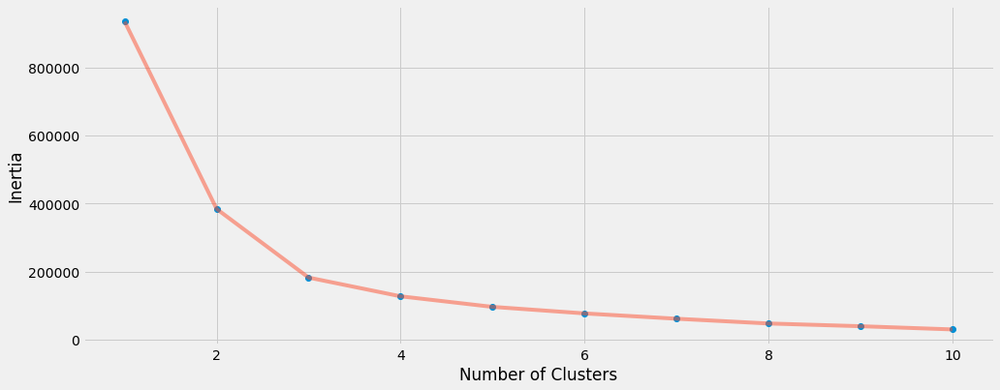

In [54]:
plt.figure(1 , figsize = (15 ,6))
plt.plot(np.arange(1 , 11) , inertia , 'o')
plt.plot(np.arange(1 , 11) , inertia , '-' , alpha = 0.5)
plt.xlabel('Number of Clusters') , plt.ylabel('Inertia')
plt.show()

In [55]:
algorithm = (KMeans(n_clusters = 3 ,init='k-means++', n_init = 10 ,max_iter=300, 
                        tol=0.0001,  random_state= 111  , algorithm='elkan') )
algorithm.fit(X1)
labels1 = algorithm.labels_
centroids1 = algorithm.cluster_centers_

In [56]:
h = 0.02
x_min, x_max = X1[:, 0].min() - 1, X1[:, 0].max() + 1
y_min, y_max = X1[:, 1].min() - 1, X1[:, 1].max() + 1
xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))
Z = algorithm.predict(np.c_[xx.ravel(), yy.ravel()]) 
plt.figure(1 , figsize = (15 , 7) )
plt.clf()
Z = Z.reshape(xx.shape)

<Figure size 1080x504 with 0 Axes>

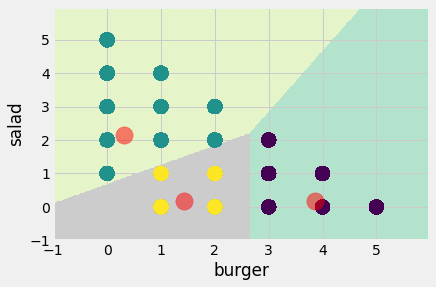

In [57]:

plt.imshow(Z , interpolation='nearest', 
           extent=(xx.min(), xx.max(), yy.min(), yy.max()),
           cmap = plt.cm.Pastel2, aspect = 'auto', origin='lower')

plt.scatter( x = 'burger' ,y = 'salad' , data = df , c = labels1 , 
            s = 200 )
plt.scatter(x = centroids1[: , 0] , y =  centroids1[: , 1] , s = 300 , c = 'red' , alpha = 0.5)
plt.ylabel('salad') , plt.xlabel('burger')
plt.show()

### 2.2 Segmentation using burger and location

In [33]:
df.head()

,ticket_id,burger,fries,salad,shake,location
0,0x10000a,1.0,1.0,0.0,0.0,9
1,0x10000a,1.0,1.0,0.0,0.0,9
2,0x100058,2.0,2.0,0.0,0.0,6
3,0x100058,2.0,2.0,0.0,0.0,6
4,0x1000c8,4.0,5.0,1.0,4.0,9


In [34]:
'''burger and location'''
X1 = df[['burger' , 'location']].iloc[: , :].values
inertia = []
for n in range(1 , 11):
    algorithm = (KMeans(n_clusters = n ,init='k-means++', n_init = 10 ,max_iter=300, 
                        tol=0.0001,  random_state= 111  , algorithm='elkan') )
    algorithm.fit(X1)
    inertia.append(algorithm.inertia_)

### 2.2 Selecting N Clusters based in Inertia (Squared Distance between Centroids and data points, should be less)

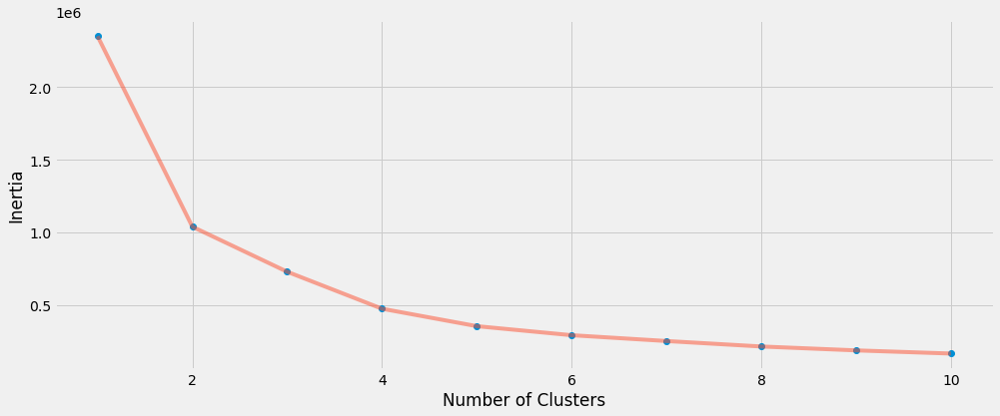

In [35]:
plt.figure(1 , figsize = (15 ,6))
plt.plot(np.arange(1 , 11) , inertia , 'o')
plt.plot(np.arange(1 , 11) , inertia , '-' , alpha = 0.5)
plt.xlabel('Number of Clusters') , plt.ylabel('Inertia')
plt.show()

In [36]:
algorithm = (KMeans(n_clusters = 2 ,init='k-means++', n_init = 10 ,max_iter=300, 
                        tol=0.0001,  random_state= 111  , algorithm='elkan') )
algorithm.fit(X1)
labels1 = algorithm.labels_
centroids1 = algorithm.cluster_centers_

In [37]:
h = 0.02
x_min, x_max = X1[:, 0].min() - 1, X1[:, 0].max() + 1
y_min, y_max = X1[:, 1].min() - 1, X1[:, 1].max() + 1
xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))
Z = algorithm.predict(np.c_[xx.ravel(), yy.ravel()]) 

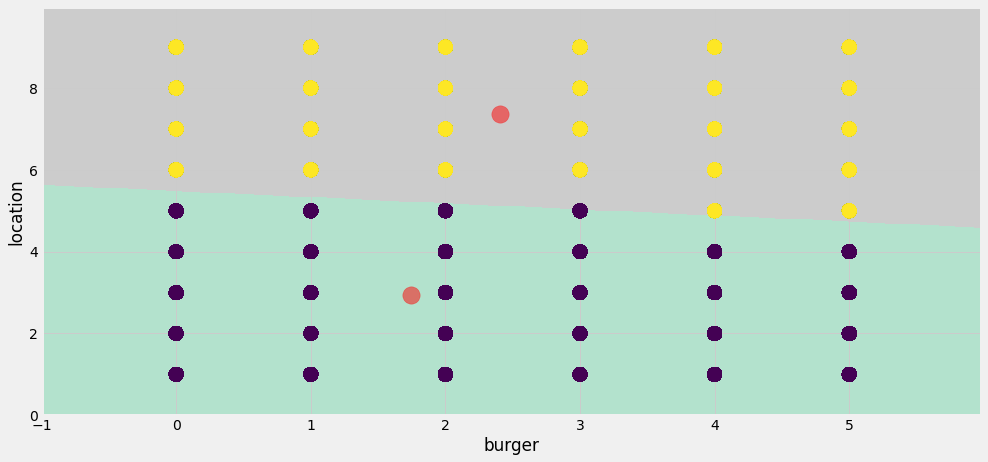

In [38]:
plt.figure(1 , figsize = (15 , 7) )
plt.clf()
Z = Z.reshape(xx.shape)
plt.imshow(Z , interpolation='nearest', 
           extent=(xx.min(), xx.max(), yy.min(), yy.max()),
           cmap = plt.cm.Pastel2, aspect = 'auto', origin='lower')

plt.scatter( x = 'burger' ,y = 'location' , data = df , c = labels1 , 
            s = 200 )
plt.scatter(x = centroids1[: , 0] , y =  centroids1[: , 1] , s = 300 , c = 'red' , alpha = 0.5)
plt.ylabel('location') , plt.xlabel('burger')
plt.show()

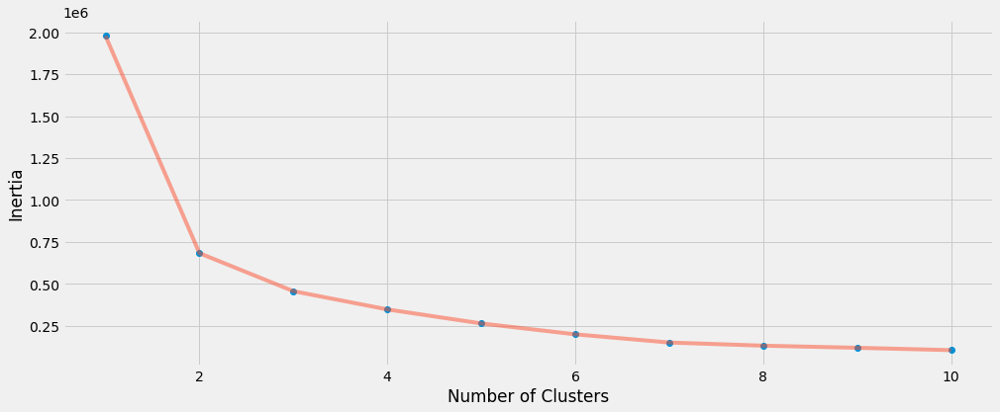

In [73]:
'''burger and location'''
X1 = df[['salad' , 'location']].iloc[: , :].values
inertia = []
for n in range(1 , 11):
    algorithm = (KMeans(n_clusters = n ,init='k-means++', n_init = 10 ,max_iter=300, 
                        tol=0.0001,  random_state= 111  , algorithm='elkan') )
    algorithm.fit(X1)
    inertia.append(algorithm.inertia_)
    
plt.figure(1 , figsize = (15 ,6))
plt.plot(np.arange(1 , 11) , inertia , 'o')
plt.plot(np.arange(1 , 11) , inertia , '-' , alpha = 0.5)
plt.xlabel('Number of Clusters') , plt.ylabel('Inertia')
plt.show()

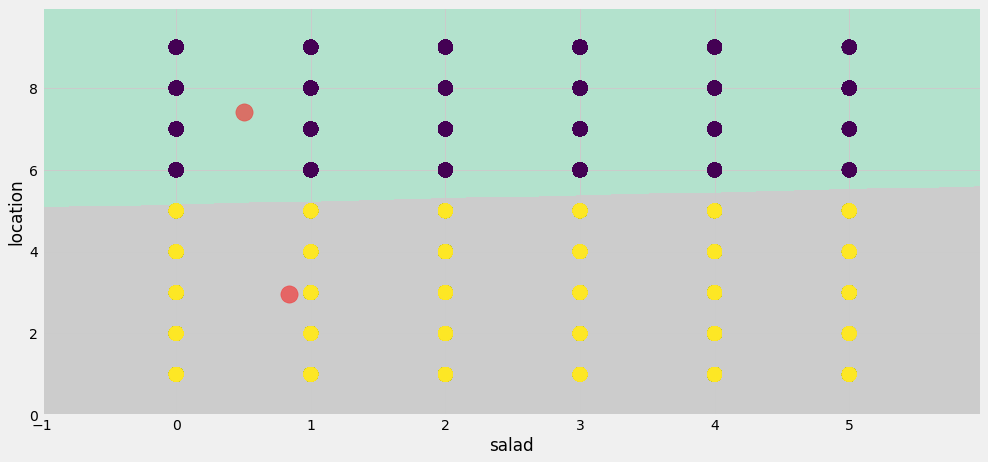

In [74]:
algorithm = (KMeans(n_clusters = 2 ,init='k-means++', n_init = 10 ,max_iter=300, 
                        tol=0.0001,  random_state= 111  , algorithm='elkan') )
algorithm.fit(X1)
labels1 = algorithm.labels_
centroids1 = algorithm.cluster_centers_
h = 0.02
x_min, x_max = X1[:, 0].min() - 1, X1[:, 0].max() + 1
y_min, y_max = X1[:, 1].min() - 1, X1[:, 1].max() + 1
xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))
Z = algorithm.predict(np.c_[xx.ravel(), yy.ravel()]) 
plt.figure(1 , figsize = (15 , 7) )
plt.clf()
Z = Z.reshape(xx.shape)
plt.imshow(Z , interpolation='nearest', 
           extent=(xx.min(), xx.max(), yy.min(), yy.max()),
           cmap = plt.cm.Pastel2, aspect = 'auto', origin='lower')

plt.scatter( x = 'salad' ,y = 'location' , data = df , c = labels1 , 
            s = 200 )
plt.scatter(x = centroids1[: , 0] , y =  centroids1[: , 1] , s = 300 , c = 'red' , alpha = 0.5)
plt.ylabel('location') , plt.xlabel('salad')
plt.show()

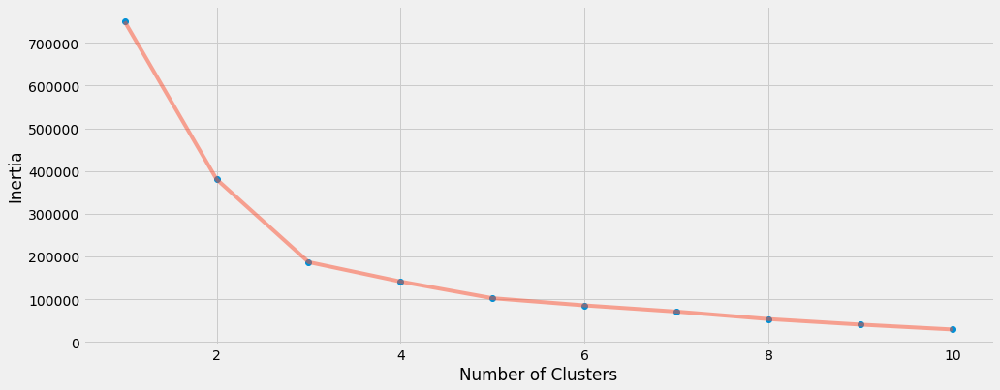

In [75]:
'''burger and location'''
X1 = df[['salad' , 'fries']].iloc[: , :].values
inertia = []
for n in range(1 , 11):
    algorithm = (KMeans(n_clusters = n ,init='k-means++', n_init = 10 ,max_iter=300, 
                        tol=0.0001,  random_state= 111  , algorithm='elkan') )
    algorithm.fit(X1)
    inertia.append(algorithm.inertia_)
    
plt.figure(1 , figsize = (15 ,6))
plt.plot(np.arange(1 , 11) , inertia , 'o')
plt.plot(np.arange(1 , 11) , inertia , '-' , alpha = 0.5)
plt.xlabel('Number of Clusters') , plt.ylabel('Inertia')
plt.show()

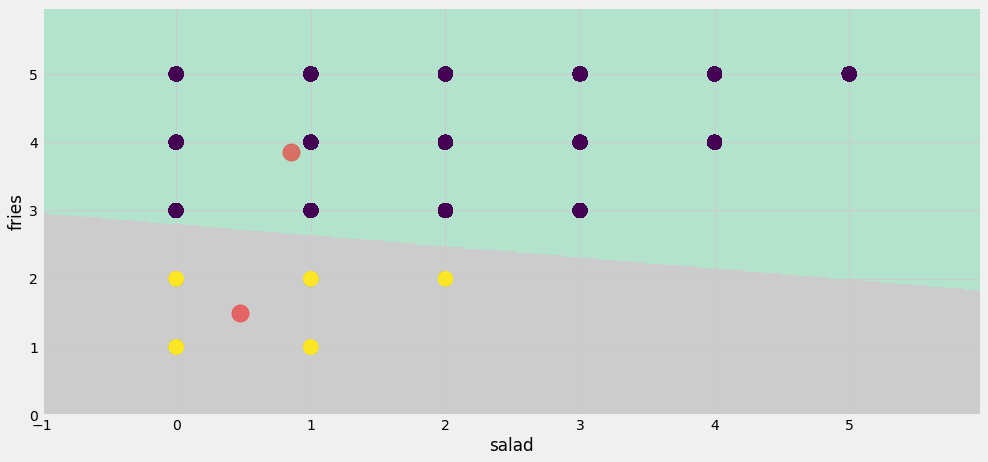

In [76]:
algorithm = (KMeans(n_clusters = 2 ,init='k-means++', n_init = 10 ,max_iter=300, 
                        tol=0.0001,  random_state= 111  , algorithm='elkan') )
algorithm.fit(X1)
labels1 = algorithm.labels_
centroids1 = algorithm.cluster_centers_
h = 0.02
x_min, x_max = X1[:, 0].min() - 1, X1[:, 0].max() + 1
y_min, y_max = X1[:, 1].min() - 1, X1[:, 1].max() + 1
xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))
Z = algorithm.predict(np.c_[xx.ravel(), yy.ravel()]) 
plt.figure(1 , figsize = (15 , 7) )
plt.clf()
Z = Z.reshape(xx.shape)
plt.imshow(Z , interpolation='nearest', 
           extent=(xx.min(), xx.max(), yy.min(), yy.max()),
           cmap = plt.cm.Pastel2, aspect = 'auto', origin='lower')

plt.scatter( x = 'salad' ,y = 'fries' , data = df , c = labels1 , 
            s = 200 )
plt.scatter(x = centroids1[: , 0] , y =  centroids1[: , 1] , s = 300 , c = 'red' , alpha = 0.5)
plt.ylabel('fries') , plt.xlabel('salad')
plt.show()

### 3.Segmentation using burger , salad and location

In [39]:
X3 = df[['burger' , 'salad' ,'location']].iloc[: , :].values
inertia = []
for n in range(1 , 11):
    algorithm = (KMeans(n_clusters = n ,init='k-means++', n_init = 10 ,max_iter=300, 
                        tol=0.0001,  random_state= 111  , algorithm='elkan') )
    algorithm.fit(X3)
    inertia.append(algorithm.inertia_)

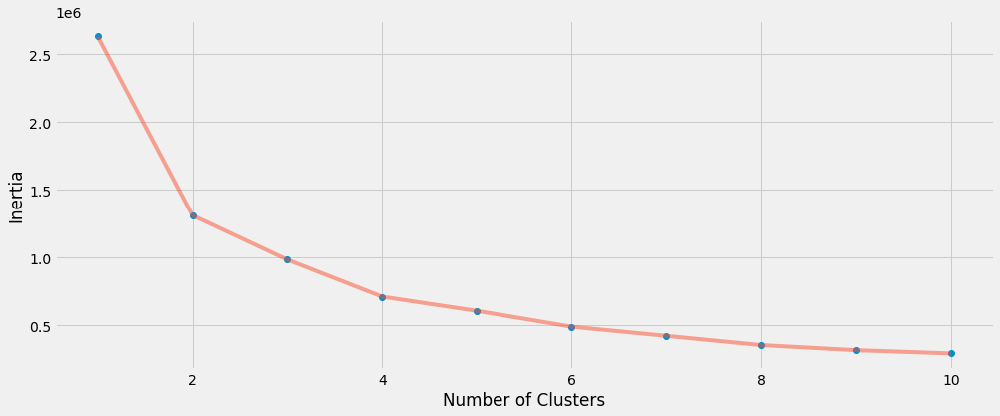

In [40]:
plt.figure(1 , figsize = (15 ,6))
plt.plot(np.arange(1 , 11) , inertia , 'o')
plt.plot(np.arange(1 , 11) , inertia , '-' , alpha = 0.5)
plt.xlabel('Number of Clusters') , plt.ylabel('Inertia')
plt.show()

In [60]:
algorithm = (KMeans(n_clusters = 4 ,init='k-means++', n_init = 10 ,max_iter=300, 
                        tol=0.0001,  random_state= 111  , algorithm='elkan') )
algorithm.fit(X3)
labels3 = algorithm.labels_
centroids3 = algorithm.cluster_centers_

In [61]:
df['label3'] =  labels3
trace1 = go.Scatter3d(
    x= df['burger'],
    y= df['salad'],
    z= df['location'],
    mode='markers',
     marker=dict(
        color = df['label3'], 
        size= 5,
        line=dict(
            color= df['label3'],
            width= 12
        ),
        opacity=0.8
     )
)
data = [trace1]
layout = go.Layout(
#     margin=dict(
#         l=0,
#         r=0,
#         b=0,
#         t=0
#     )
    title= 'Clusters',
    scene = dict(
            xaxis = dict(title  = 'burger'),
            yaxis = dict(title  = 'salad'),
            zaxis = dict(title  = 'location')
        )
)
fig = go.Figure(data=data, layout=layout)
py.offline.iplot(fig)

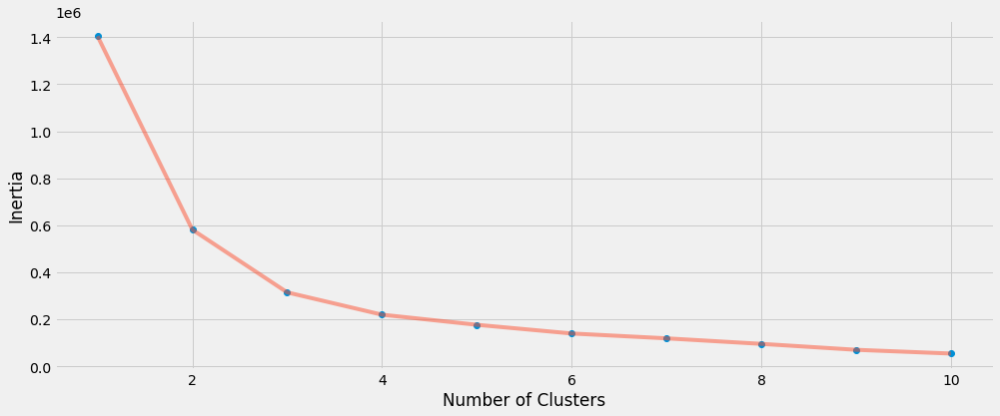

In [62]:
X3 = df[['burger' , 'salad' ,'fries']].iloc[: , :].values
inertia = []
for n in range(1 , 11):
    algorithm = (KMeans(n_clusters = n ,init='k-means++', n_init = 10 ,max_iter=300, 
                        tol=0.0001,  random_state= 111  , algorithm='elkan') )
    algorithm.fit(X3)
    inertia.append(algorithm.inertia_)
plt.figure(1 , figsize = (15 ,6))
plt.plot(np.arange(1 , 11) , inertia , 'o')
plt.plot(np.arange(1 , 11) , inertia , '-' , alpha = 0.5)
plt.xlabel('Number of Clusters') , plt.ylabel('Inertia')
plt.show()

In [78]:
algorithm = (KMeans(n_clusters = 2 ,init='k-means++', n_init = 10 ,max_iter=300, 
                        tol=0.0001,  random_state= 111  , algorithm='elkan') )
algorithm.fit(X3)
labels3 = algorithm.labels_
centroids3 = algorithm.cluster_centers_

In [79]:
df['label3'] =  labels3
trace1 = go.Scatter3d(
    x= df['burger'],
    y= df['salad'],
    z= df['fries'],
    mode='markers',
     marker=dict(
        color = df['label3'], 
        size= 13,
        line=dict(
            color= df['label3'],
            width= 12
        ),
        opacity=0.6
     )
)
data = [trace1]
layout = go.Layout(
#     margin=dict(
#         l=0,
#         r=0,
#         b=0,
#         t=0
#     )
    title= 'Clusters',
    scene = dict(
            xaxis = dict(title  = 'burger'),
            yaxis = dict(title  = 'salad'),
            zaxis = dict(title  = 'fries')
        )
)
fig = go.Figure(data=data, layout=layout)
py.offline.iplot(fig)

time

location 人數